Text(0, 0.5, '観光地数')

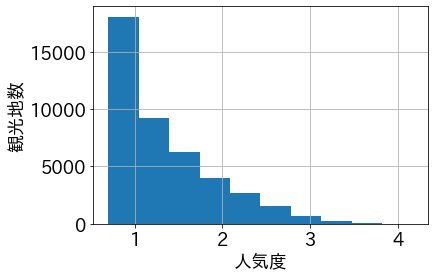

In [3]:
import japanize_matplotlib
plt.rcParams['font.size'] = 18
df = pd.read_csv('/home/yamanishi/project/trip_recommend/data/jalan/spot/experience_light.csv')
np.log10(df['review_count']).hist()
plt.xlabel('人気度')
plt.ylabel('観光地数')


In [2]:
import matplotlib
import japanize_matplotlib
plt.rcParams['font.size']=18
plt.xlabel('人気度')
plt.ylabel('観光地数')
df = pd.read_csv('/home/yamanishi/project/trip_recommend/data/jalan/spot/experience_light.csv')
plt.hist(np.log10(df['review_count']))

ModuleNotFoundError: No module named 'japanize_matplotlib'

In [ ]:
df = pd.read_csv('/home/yamanishi/project/trip_recommend/data/jalan/spot/experience_light.csv')

In [1]:
df = pd.read_csv('/home/yamanishi/project/trip_recommend/data/jalan/spot/experience_light.csv')
spot_emb = torch.load('/home/yamanishi/project/trip_recommend/model/popularity_final/data/spot_emb.pt').cpu().detach().numpy()

In [2]:
from sklearn.metrics.pairwise import cosine_similarity
spot_similarity = cosine_similarity(spot_emb, spot_emb)
spot_names = df['spot_name']

In [3]:
spot_pref = {spot:pref for spot,pref in zip(df['spot_name'], df['prefecture'])}
def make_tex(spot_id):
    spot_name = spot_names[spot_id]
    tex_text = ''
    tex_text+=spot_name
    tex_text+=' '
    pref = spot_pref[spot_name]
    tex_text+=f'(pref)'
    tex_text+='& \begin{tabular}{l}'
    spot_names, scores = nn(spot_id)
    for i, (n,s) in enumerate(zip(spot_names, scores)):
        if i==0:
            continue
        tex_text+=n
        tex_text+=' '
        pref = spot_pref[n]
        tex_text+=f'(pref)'
        tex_text+=f' (s),'
        if i==5:
            break

    return tex_text

tex_text = ''
spot_names, scores = nn(0)
for i, (n,s) in enumerate(zip(spot_names, scores)):
    print(n,s)

NameError: name 'nn' is not defined

In [ ]:
make_tex(0)

In [13]:
spot_pref = {spot:pref for spot, pref in zip(df['spot_name'], df['prefecture'])}
def nn(spot_id):
    similarity = spot_similarity[spot_id]
    K = 10

    # ソートはされていない上位k件のインデックス
    unsorted_max_indices = np.argpartition(-similarity, K)[:K]

    # 上位k件の値
    y = similarity[unsorted_max_indices]

    # 大きい順にソートし、インデックスを取得
    indices = np.argsort(-y)

    # 類似度上位k件のインデックス
    max_k_indices = unsorted_max_indices[indices]
    scores = similarity[max_k_indices]
    return spot_names[max_k_indices], scores

spot_names, scores = nn(0)
for i, (n,s) in enumerate(zip(spot_names, scores)):
    print(n, spot_pref[n], s)

函館山 1.0000001
函館山展望台 0.9999932
四方指展望台 0.99996763
長崎ロープウェイ 0.9999602
那須高原展望台 恋人の聖地 0.99994874
別府ロープウェイ 0.9999401
アクトタワー 0.99994
伊豆パノラマパーク 0.9999396
沼津港大型展望水門びゅうお 0.99993944
寒霞渓ロープウェイ 0.9999391


t-sneによる可視化

In [ ]:
spot_emb = torch.load('/home/yamanishi/project/trip_recommend/model/popularity_final/data/spot_emb.pt').cpu().detach().numpy()
df = pd.read_csv('/home/yamanishi/project/trip_recommend/data/jalan/spot/experience_light.csv')
from sklearn.manifold import TSNE
def visualize(h, color):
    z = TSNE(n_components=2).fit_transform(h)

    plt.figure(figsize=(10,10))
    plt.xticks([])
    plt.yticks([])

    plt.scatter(z[:, 0], z[:, 1], s=70, c=color, cmap="Set2")
    plt.show()

In [ ]:
visualize(spot_emb, df['prefecture'].values, random_state=42)

/home/yamanishi/.pyenv/versions/miniconda3-latest/envs/study_group/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/home/yamanishi/.pyenv/versions/miniconda3-latest/envs/study_group/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


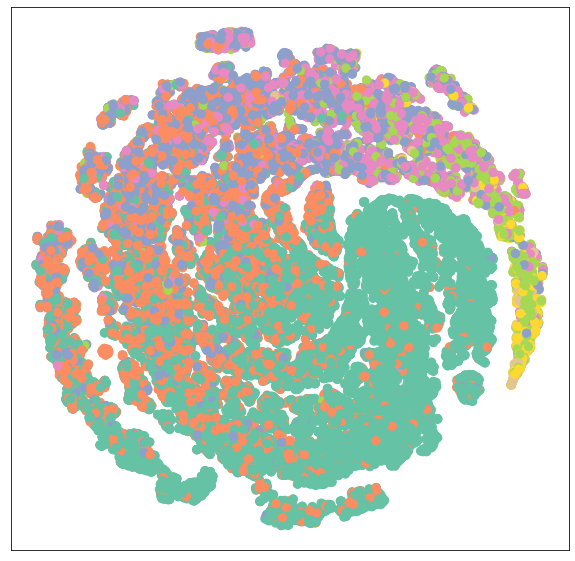

In [3]:
visualize(spot_emb, np.log10(df['review_count'].values))

In [4]:
visualize(spot_emb, df['prefecture'].values)

/home/yamanishi/.pyenv/versions/miniconda3-latest/envs/study_group/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/home/yamanishi/.pyenv/versions/miniconda3-latest/envs/study_group/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


tfidfの表示

wordのpopularityとlimeのスコアの相関

In [23]:
from collections import defaultdict
tfidf_top_words = np.load('/home/yamanishi/project/trip_recommend/data/jalan/graph/tfidf_top_words.npy')
d = defaultdict(int)
d_count = defaultdict(int)

for ind,i in enumerate(tfidf_top_words):
    spot_name = df.loc[ind, 'spot_name']
    review_count = df.loc[ind, 'review_count']
    for j in i:
        d[j]+=1
        d_count[j]+=review_count
        #if j=='函館山':
        #    print(spot_name, review_count)

    
d_sort=sorted(d.items(), key=lambda x:x[1],reverse=True)
d_popular = {k:d_count[k]/d[k] for k in d.keys()}
d_popular_sort = sorted(d_popular.items(), key=lambda x:x[1], reverse=True)
for k,v in d_popular_sort:
    if d[k]>2000:
        print(k,v, d[k])

神社 88.94721299372462 2709
展示 84.3561597851628 2979
温泉 73.43912087912088 4550
風呂 73.14520547945206 2190
公園 71.14950566674705 4147
体験 63.17004274298458 5381
遊び 51.93411967779056 3476
らん 51.56348039215686 4080


In [25]:
d_sort[:5]

[('体験', 5381), ('温泉', 4550), ('公園', 4147), ('らん', 4080), ('遊び', 3476)]

In [27]:
df= pd.read_csv('/home/yamanishi/project/trip_recommend/model/popularity_final/result/result.csv')

In [28]:
df.head()

,0.63615,4,deeptour,4.1,128,True,True.1,True.2,False,False.1,False.2
0,0.80500,25,deeptour,1,128,True,False,False,False,False,False
1,0.78654,2,deeptour,2,128,True,False,False,False,False,False
2,0.78275,2,deeptour,3,128,True,False,False,False,False,False
3,0.76616,0,deeptour,4,128,True,False,False,False,False,False
4,0.77064,0,deeptour,5,128,True,False,False,False,False,False


地図の可視化

In [3]:
#保存先　popularity_final/data/japan_pop_all.pdf
import folium
df = pd.read_csv('/home/yamanishi/project/trip_recommend/data/jalan/spot/experience_light.csv')
df['y'] = np.log10(df['review_count'])
map = folium.Map(location=[36, 135.5], zoom_start=5)
def calc_color(score):
    return int(score/0.5)*0.5
color={0:'purple', 0.5:'beige', 1: 'lghtgreen',1.5:'green', 2:'yellow', 2.5:'orange', 3:'red', 3.5: 'red', 4.0:'cyan'}
for name, lat, lng, gt in zip(df['spot_name'],df['latitude'], df['longitude'], df['y']):
    folium.Circle(
        location=[lat, lng],
        radius=0.01,
        color=color[calc_color(gt)],
        fill=False
    ).add_to(map)
map.save('../data/japan_pop_all.html')
map.save('../data/japan_pop_all.pdf')
map

In [6]:
#保存先　popularity_final/data/japan_pop_gt.pdf
import folium
df = pd.read_csv('/home/yamanishi/project/trip_recommend/data/jalan/spot/experience_light.csv')
test_result = pd.read_csv('/home/yamanishi/project/trip_recommend/model/popularity/data/test_result.csv')
test_result = test_result.rename(columns={'spot_names':'spot_name'})
test_result = pd.merge(test_result, df, on='spot_name')
map = folium.Map(location=[36, 135.5], zoom_start=6)
def calc_color(score):
    return int(score/0.5)*0.5
color={0:'purple', 0.5:'beige', 1: 'lghtgreen',1.5:'green', 2:'yellow', 2.5:'orange', 3:'red', 3.5: 'red'}
for name, lat, lng, gt in zip(test_result['spot_name'],test_result['latitude'], test_result['longitude'], test_result['gt']):
    folium.Circle(
        location=[lat, lng],
        radius=3,
        color=color[calc_color(gt)],
        fill=False
    ).add_to(map)

map
import io
from PIL import Image
map.save('../data/japan_pop_gt.html')
map.save('../data/japan_pop_gt.pdf')


In [ ]:
#保存先　popularity_final/data/japan_pop_pred.pdf
test_result = pd.read_csv('/home/yamanishi/project/trip_recommend/model/popularity/data/test_result.csv')
test_result = test_result.rename(columns={'spot_names':'spot_name'})
test_result = pd.merge(test_result, df, on='spot_name')
map = folium.Map(location=[36, 135.5], zoom_start=6)
def calc_color(score):
    return int(score/0.5)*0.5
color={0:'purple', 0.5:'beige', 1: 'lghtgreen',1.5:'green', 2:'yellow', 2.5:'orange', 3:'red', 3.5: 'red'}
for name, lat, lng, gt in zip(test_result['spot_name'],test_result['latitude'], test_result['longitude'], test_result['pred']):
    folium.Circle(
        location=[lat, lng],
        radius=5,
        color=color[calc_color(gt)],
        fill=False
    ).add_to(map)

map.save('../data/japan_pop_pred.html')
map.save('../data/japan_pop_pred.pdf')
map


In [1]:
import geopandas
gdf = gpd.read_file('/home/yamanishi/project/trip_recommend/model/popularity_final/data/japan_ver84/japan_ver84/japan_ver84.shp')
gdf.head()

/home/yamanishi/.pyenv/versions/miniconda3-latest/envs/study_group/lib/python3.7/site-packages/geopandas/_compat.py:110: UserWarning: The Shapely GEOS version (3.10.2-CAPI-1.16.0) is incompatible with the GEOS version PyGEOS was compiled with (3.10.3-CAPI-1.16.1). Conversions between both will be slow.
  shapely_geos_version, geos_capi_version_string


NameError: name 'gpd' is not defined

In [1]:
df = pd.read_csv('/home/yamanishi/project/trip_recommend/data/jalan/spot/experience_light.csv')

In [8]:
df['latitude'].max()

45.5228893

In [10]:
edge2000=np.load('/home/yamanishi/project/trip_recommend/data/jalan/graph/spot_spot_edge_2000.npy')

In [13]:
lat = {ind:lat for ind, lat in enumerate(df['latitude'])}
lon = {ind:lon for ind, lon in enumerate(df['longitude'])}

In [29]:
def calc_dist_lat(lat1, lat2):
    lat_diff = lat1-lat2
    return 111*1000*lat_diff

def calc_dist_lon(lon1, lon2):
    lon_diff = lon1-lon2
    return 90* 1000*lon_diff
from collections import defaultdict
spot_to_category = defaultdict(list)
spot_category = np.load('/home/yamanishi/project/trip_recommend/data/jalan/graph/spot_category.npy')
for spot, category in zip(spot_category[0], spot_category[1]):
    spot_to_category[spot].append(category)

In [22]:
-999//200

-5

In [37]:
from tqdm import tqdm
spatial_heatmap = np.zeros((42852, 290, 10, 10))
for spot_from, spot_to in tqdm(zip(edge2000[0], edge2000[1])):
    lat_diff = calc_dist_lat(lat[spot_from], lat[spot_to])
    lon_diff = calc_dist_lon(lon[spot_from], lon[spot_to])
    if abs(lat_diff)<1000 and abs(lon_diff)<1000:
        lat_diff = int(lat_diff//200+5)
        lon_diff = int(lon_diff//200+5)
        for c in spot_to_category[spot_to]:
            #print(spot_from,c,lat_diff,lon_diff)
            spatial_heatmap[spot_from,c,lat_diff,lon_diff]+=1

862975it [00:03, 270115.70it/s]


In [38]:
np.save('/home/yamanishi/project/trip_recommend/data/jalan/graph/spatial_heatmap.npy', spatial_heatmap)

In [40]:
spatial_heatmap.shape

(42852, 290, 10, 10)

In [47]:
conv1 = torch.nn.Conv2d(290, 10, kernel_size=3, stride=1)
pool = torch.nn.MaxPool2d(3, stride=2)
pool(conv1(torch.tensor(spatial_heatmap).float().relu())).size()

torch.Size([42852, 10, 3, 3])

In [11]:
edge2000[:,edge2000[0]==0]

array([[    0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0],
       [    0,  1361,  1328,    21,  2107,   252,   144,   736,   701,
          667,   566,   465,    23,   473,   113,  1827,  1686,   157,
        39963,  1318,   547,  1359,  1832,   340,   724,  1818,  1382,
          143,  1984,  1276,   841,   832,   817,  1204, 39957,  1835,
           52,  1680,  2087,   814,  1694,  1282,  2037,   370,   392,
         1340,    95,  1924,   154,  1220,  1189,  2188,  1085,  2056,
         1506,    6

In [10]:
import statistics
for p in df['prefecture'].unique():
    df_tmp = df[df['prefecture']==p]
    print(p, statistics.mean(np.log10(df_tmp['review_count'])), statistics.pstdev(np.log10(df_tmp['review_count'])))

北海道 1.390229437967197 0.6015943488107295
青森県 1.3236411919294704 0.5504405490989484
岩手県 1.3232325230673065 0.5492151960186613
宮城県 1.3621124731105227 0.5806184129711169
秋田県 1.2746516927255638 0.5316254498978353
山形県 1.3191621521678434 0.5215989157066933
福島県 1.302151495945016 0.5430477281087095
栃木県 1.3703760301538939 0.5696939930337163
群馬県 1.3266266534633364 0.5853035031915699
茨城県 1.284703386491646 0.5320656639025041
埼玉県 1.371186575615257 0.567731710669677
千葉県 1.3752035823095865 0.5985406154620541
東京都 1.4191163411702035 0.6389341249205821
神奈川県 1.4026263993247485 0.6317615127727544
山梨県 1.3429169430130838 0.5569935620083022
長野県 1.2788529544174332 0.5434324924352397
新潟県 1.2367952971748726 0.5248624462322187
富山県 1.323493515082262 0.5533623406174144
石川県 1.3065188344332928 0.5794869476328065
福井県 1.2858338846147142 0.4545294390514151
静岡県 1.3372893682575266 0.5970027674757639
岐阜県 1.2957598360933622 0.5341069449090247
愛知県 1.3625700435996968 0.5989395102986612
三重県 1.2748123886440192 0.56942604209139

In [ ]:
import torch.nn as nn
lstm = nn.LSTM(40, 40)
lstm()

In [4]:
conv = torch.nn.Conv2d(10, 20, kernel_size=3, stride=1)
conv(torch.rand(400, 10, 10,10)).size()

torch.Size([400, 20, 8, 8])

In [6]:
pool = torch.nn.MaxPool2d(3, stride=2)
pool(conv(torch.rand(400, 10, 10,10))).size()

torch.Size([400, 20, 3, 3])